In [1]:
import pandas as pd 
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import pycountry
import plotly.graph_objects as go
import plotly.express as px
from pandas.plotting import parallel_coordinates

In [2]:
all_data = pd.read_csv('./data/fifa/all_players.csv')
all_data.drop(['Unnamed: 0', 'Height', 'Weight', 'Alternative positions', 'play style', 'url'], axis = 1, inplace= True)

all_data

/var/folders/yk/fs7s5htj44b8ds6qh_c6gb0m0000gn/T/ipykernel_72630/2329133090.py:1: DtypeWarning: Columns (33) have mixed types. Specify dtype option on import or set low_memory=False.
  all_data = pd.read_csv('./data/fifa/all_players.csv')


,Rank,Name,OVR,PAC,SHO,PAS,DRI,DEF,PHY,Acceleration,...,Preferred foot,Age,Nation,League,Team,GK Diving,GK Handling,GK Kicking,GK Positioning,GK Reflexes
0,1,Kylian Mbappé,91,97,90,80,92,36,78,97,...,Right,25,France,LALIGA EA SPORTS,Real Madrid,NaN,NaN,NaN,NaN,NaN
1,2,Rodri,91,66,80,86,84,87,85,65,...,Right,28,Spain,Premier League,Manchester City,NaN,NaN,NaN,NaN,NaN
2,4,Erling Haaland,91,88,92,70,81,45,88,80,...,Left,24,Norway,Premier League,Manchester City,NaN,NaN,NaN,NaN,NaN
3,5,Jude Bellingham,90,80,87,83,88,78,83,81,...,Right,21,England,LALIGA EA SPORTS,Real Madrid,NaN,NaN,NaN,NaN,NaN
4,7,Vini Jr.,90,95,84,81,91,29,69,95,...,Right,24,Brazil,LALIGA EA SPORTS,Real Madrid,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
17732,17146,Araya Dennis,53,42,57,49,52,25,42,44,...,Right,18,England,Barclays WSL,Spurs,NaN,NaN,NaN,NaN,NaN
17733,17146,Alexia Férnandez,53,53,55,51,53,34,47,52,...,Right,22,Spain,Liga F,Granada CF,NaN,NaN,NaN,NaN,NaN
17734,17146,Aleigh Gambone,53,60,58,53,56,49,53,58,...,Right,23,United States,Scottish Women's League,Glasgow City FC,NaN,NaN,NaN,NaN,NaN
17735,17146,Joy Lysser,53,61,52,48,56,53,58,60,...,Left,20,Switzerland,Schweizer Damen Liga,FC Zürich,NaN,NaN,NaN,NaN,NaN


In [3]:
#RM
rm_data = all_data[all_data['Position'] == 'RM']
rm_data.sort_values('OVR', ascending=False)[:30]
rm_data.reset_index(inplace=True)
rm_data.drop(columns='index', axis=1, inplace=True)
rm_data.head()

/var/folders/yk/fs7s5htj44b8ds6qh_c6gb0m0000gn/T/ipykernel_72630/3233799656.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  rm_data.drop(columns='index', axis=1, inplace=True)


,Rank,Name,OVR,PAC,SHO,PAS,DRI,DEF,PHY,Acceleration,...,Preferred foot,Age,Nation,League,Team,GK Diving,GK Handling,GK Kicking,GK Positioning,GK Reflexes
0,101,Riyad Mahrez,85,79,81,81,88,39,62,83,...,Left,33,Algeria,ROSHN Saudi League,Al Ahli,NaN,NaN,NaN,NaN,NaN
1,101,Cole Palmer,85,75,82,83,86,50,66,73,...,Left,22,England,Premier League,Chelsea,NaN,NaN,NaN,NaN,NaN
2,101,Leroy Sané,85,90,83,80,86,37,70,89,...,Left,28,Germany,Bundesliga,FC Bayern München,NaN,NaN,NaN,NaN,NaN
3,149,Jeremie Frimpong,84,93,62,75,86,75,69,96,...,Right,23,Holland,Bundesliga,Leverkusen,NaN,NaN,NaN,NaN,NaN
4,222,Ángel Di María,83,76,80,85,88,48,66,78,...,Left,36,Argentina,Liga Portugal,SL Benfica,NaN,NaN,NaN,NaN,NaN


In [4]:
#RW
rw_data = all_data[all_data['Position'] == 'RW']
rw_data.sort_values('OVR', ascending=False)[:30]
rw_data.reset_index(inplace=True)
rw_data.drop(columns='index', inplace=True)
rw_data.head()

/var/folders/yk/fs7s5htj44b8ds6qh_c6gb0m0000gn/T/ipykernel_72630/808170096.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  rw_data.drop(columns='index', inplace=True)


,Rank,Name,OVR,PAC,SHO,PAS,DRI,DEF,PHY,Acceleration,...,Preferred foot,Age,Nation,League,Team,GK Diving,GK Handling,GK Kicking,GK Positioning,GK Reflexes
0,22,Mohamed Salah,89,89,87,82,88,45,75,89,...,Left,32,Egypt,Premier League,Liverpool,NaN,NaN,NaN,NaN,NaN
1,23,Phil Foden,88,86,86,85,90,57,63,89,...,Left,24,England,Premier League,Manchester City,NaN,NaN,NaN,NaN,NaN
2,25,Lionel Messi,88,79,85,87,92,33,64,86,...,Left,37,Argentina,MLS,Inter Miami CF,NaN,NaN,NaN,NaN,NaN
3,47,Bukayo Saka,87,85,83,81,88,60,70,88,...,Left,23,England,Premier League,Arsenal,NaN,NaN,NaN,NaN,NaN
4,72,Rodrygo,86,89,81,79,88,31,64,90,...,Right,23,Brazil,LALIGA EA SPORTS,Real Madrid,NaN,NaN,NaN,NaN,NaN


In [5]:
rm_stats = ['OVR', 'PAC', 'Dribbling', 'Short Passing', 'Stamina', 'Ball Control', 'Long Passing']
rw_stats = ['OVR', 'PAC', 'Finishing', 'Crossing', 'Shot Power', 'Positioning', 'Composure']

In [6]:
fig = go.Figure()

for player in rm_data.Name:
    player_data = rm_data[rm_data['Name'] == player][rm_stats].values.flatten()
    fig.add_trace(
        go.Bar(
            x=rm_stats,
            y=player_data,
            name=player,
            visible=False
        )
    )

fig.data[0].visible = True


fig.update_layout(
    updatemenus=[
        dict(
            buttons=[
                dict(
                    args=[{"visible": [i == j for i in range(len(rm_data['Name']))]}],  
                    label=player,
                    method='update'
                )
                for j, player in enumerate(rm_data['Name'])  
            ],
            direction='down',
            showactive=True,
        )
    ]
)

fig.update_layout(
    title='Best 30 RM',
    xaxis_title='Attributes',
    yaxis_title='Value',
    showlegend=False
)

fig.show()

In [7]:
for stat in rm_stats:
    print(f'Name {rm_data.Name[rm_data[stat].idxmax()]}, index: {rm_data[stat].idxmax()}, best atribute is: {stat} and its value is: {rm_data[stat].iloc[rm_data[stat].idxmax()]}')

Name Riyad Mahrez, index: 0, best atribute is: OVR and its value is: 85
Name Moussa Diaby, index: 5, best atribute is: PAC and its value is: 95
Name Ángel Di María, index: 4, best atribute is: Dribbling and its value is: 89
Name Sandy Baltimore, index: 898, best atribute is: Short Passing and its value is: 87
Name Reinhold Ranftl, index: 320, best atribute is: Stamina and its value is: 94
Name Riyad Mahrez, index: 0, best atribute is: Ball Control and its value is: 90
Name Cole Palmer, index: 1, best atribute is: Long Passing and its value is: 82


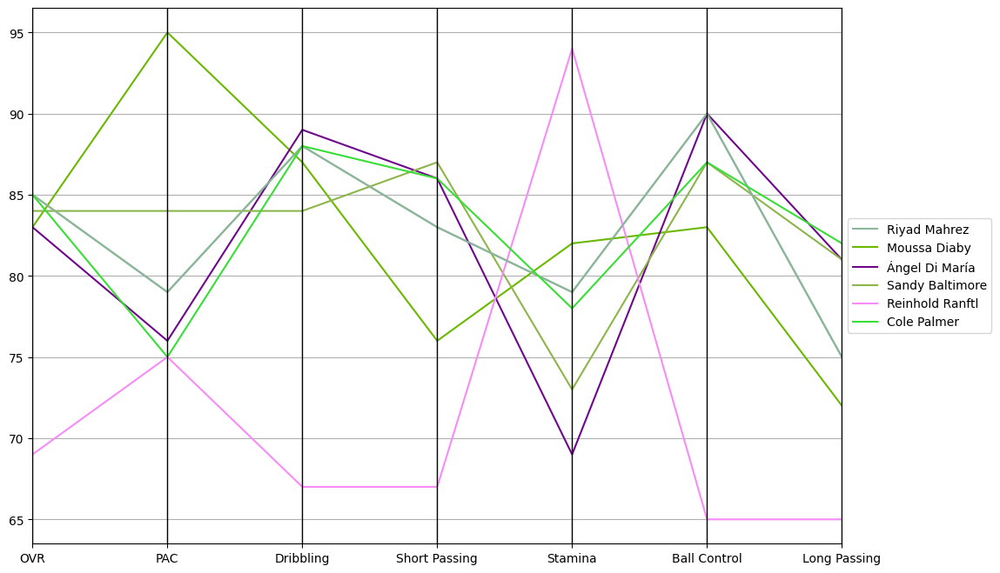

In [8]:
best_rm = rm_data.loc[rm_data[rm_stats].idxmax()]

plt.figure(figsize=(12,8))
parallel_coordinates(best_rm, class_column='Name', cols=rm_stats)
plt.legend(loc='center left', bbox_to_anchor=(1,0.5))
plt.show()

1) Riyad Mahrez
2) Angel Di Maria/ Moussa Diaby

In [9]:
rw_data = all_data[all_data['Position'] == 'RW']
rw_data = rw_data.sort_values('OVR', ascending=False)[:30]
rw_data.reset_index(inplace=True)
rw_data.drop(columns='index', inplace=True)
rw_data.head()

,Rank,Name,OVR,PAC,SHO,PAS,DRI,DEF,PHY,Acceleration,...,Preferred foot,Age,Nation,League,Team,GK Diving,GK Handling,GK Kicking,GK Positioning,GK Reflexes
0,8,Caroline Graham Hansen,90,89,87,88,90,47,76,90,...,Right,29,Norway,Liga F,FC Barcelona,NaN,NaN,NaN,NaN,NaN
1,22,Mohamed Salah,89,89,87,82,88,45,75,89,...,Left,32,Egypt,Premier League,Liverpool,NaN,NaN,NaN,NaN,NaN
2,35,Beth Mead,88,82,84,84,88,67,73,83,...,Right,29,England,Barclays WSL,Arsenal,NaN,NaN,NaN,NaN,NaN
3,23,Phil Foden,88,86,86,85,90,57,63,89,...,Left,24,England,Premier League,Manchester City,NaN,NaN,NaN,NaN,NaN
4,27,Kadidiatou Diani,88,90,85,81,88,56,79,89,...,Right,29,France,Arkema PL,OL,NaN,NaN,NaN,NaN,NaN


In [10]:
#RW
fig = go.Figure()

for player in rw_data.Name:
    player_data = rw_data[rw_data['Name'] == player][rw_stats].values.flatten()
    fig.add_trace(
        go.Bar(
            x=rw_stats,
            y=player_data,
            name=player,
            visible=False
        )
    )

fig.data[0].visible = True


fig.update_layout(
    updatemenus=[
        dict(
            buttons=[
                dict(
                    args=[{"visible": [i == j for i in range(len(rw_data['Name']))]}],  
                    label=player,
                    method='update'
                )
                for j, player in enumerate(rw_data['Name'])  
            ],
            direction='down',
            showactive=True,
        )
    ]
)

fig.update_layout(
    title='Best 30 RW',
    xaxis_title='Attributes',
    yaxis_title='Value',
    showlegend=False
)

fig.show()

In [11]:
for stat in rw_stats:
    print(f'Name: {rw_data.Name[rw_data[stat].idxmax()]}, ability {stat}, value: {rw_data[stat].iloc[rw_data[stat].idxmax()]}')

Name: Caroline Graham Hansen, ability OVR, value: 90
Name: Federico Chiesa, ability PAC, value: 93
Name: Mohamed Salah, ability Finishing, value: 90
Name: Caroline Graham Hansen, ability Crossing, value: 90
Name: Phil Foden, ability Shot Power, value: 89
Name: Mohamed Salah, ability Positioning, value: 92
Name: Lionel Messi, ability Composure, value: 94


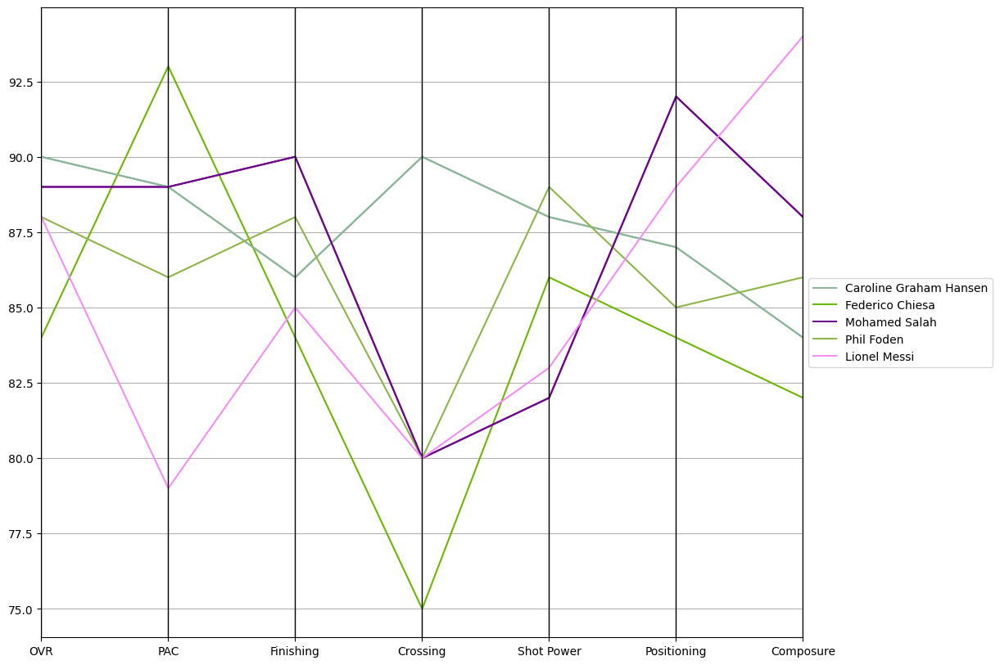

In [12]:
rw_best = rw_data.loc[rw_data[rw_stats].idxmax()]

plt.figure(figsize=(12,10))
parallel_coordinates(rw_best, class_column='Name', cols=rw_stats)
plt.legend(loc = 'center left', bbox_to_anchor=(1,0.5))
plt.show()


1) Caroline Graham Hansen
2) Mohamed Salah, Lionel Messi